# ODSC TTS Workshop: Brand Voice
Within this notebook you will:
- setup the environment for the TTS solution
- load the interactive logs from the training session of the aligner and spectrogram model
- load, predict and customize the results of the TTS and Vocoder models 

## Environment setup

In [1]:
!git clone https://github.com/as-ideas/TransformerTTS.git

Cloning into 'TransformerTTS'...
remote: Enumerating objects: 49, done.
remote: Counting objects: 100% (49/49), done.
remote: Compressing objects: 100% (36/36), done.
remote: Total 3510 (delta 24), reused 28 (delta 13), pack-reused 3461
Receiving objects: 100% (3510/3510), 11.53 MiB | 17.34 MiB/s, done.
Resolving deltas: 100% (2394/2394), done.


In [2]:
!cd ./TransformerTTS; git checkout vocoding
# Install requirements
!apt-get install -y espeak
!pip install -r TransformerTTS/requirements.txt
!pip install -r TransformerTTS/vocoding/extra_requirements.txt

Branch 'vocoding' set up to track remote branch 'vocoding' from 'origin'.
Switched to a new branch 'vocoding'
Reading package lists... Done
Building dependency tree       
Reading state information... Done
The following additional packages will be installed:
  espeak-data libespeak1 libportaudio2 libsonic0
The following NEW packages will be installed:
  espeak espeak-data libespeak1 libportaudio2 libsonic0
0 upgraded, 5 newly installed, 0 to remove and 30 not upgraded.
Need to get 1,219 kB of archives.
After this operation, 3,031 kB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu bionic/universe amd64 libportaudio2 amd64 19.6.0-1 [64.6 kB]
Get:2 http://archive.ubuntu.com/ubuntu bionic/main amd64 libsonic0 amd64 0.2.0-6 [13.4 kB]
Get:3 http://archive.ubuntu.com/ubuntu bionic/universe amd64 espeak-data amd64 1.48.04+dfsg-5 [934 kB]
Get:4 http://archive.ubuntu.com/ubuntu bionic/universe amd64 libespeak1 amd64 1.48.04+dfsg-5 [145 kB]
Get:5 http://archive.ubunt

In [3]:
!wget https://public-asai-dl-models.s3.eu-central-1.amazonaws.com/hifigan.zip
!wget https://public-asai-dl-models.s3.eu-central-1.amazonaws.com/ljspeech_logs.zip
!unzip -q hifigan.zip
!unzip -q ljspeech_logs.zip;
!mv hifigan/en/* TransformerTTS/vocoding/hifigan/en/
!rm -rf hifigan
!rm *.zip

--2021-03-22 11:07:48--  https://public-asai-dl-models.s3.eu-central-1.amazonaws.com/hifigan.zip
Resolving public-asai-dl-models.s3.eu-central-1.amazonaws.com (public-asai-dl-models.s3.eu-central-1.amazonaws.com)... 52.219.47.225
Connecting to public-asai-dl-models.s3.eu-central-1.amazonaws.com (public-asai-dl-models.s3.eu-central-1.amazonaws.com)|52.219.47.225|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 51874346 (49M) [application/zip]
Saving to: ‘hifigan.zip’

hifigan.zip         100%[===================>]  49.47M  14.6MB/s    in 3.4s    

2021-03-22 11:07:52 (14.6 MB/s) - ‘hifigan.zip’ saved [51874346/51874346]

--2021-03-22 11:07:52--  https://public-asai-dl-models.s3.eu-central-1.amazonaws.com/ljspeech_logs.zip
Resolving public-asai-dl-models.s3.eu-central-1.amazonaws.com (public-asai-dl-models.s3.eu-central-1.amazonaws.com)... 52.219.74.196
Connecting to public-asai-dl-models.s3.eu-central-1.amazonaws.com (public-asai-dl-models.s3.eu-central-1.amazon

## Tensorboard session

In [4]:
%load_ext tensorboard
%tensorboard --logdir ljspeech_logs

<IPython.core.display.Javascript object>

## Models playground

### Load models

In [6]:
cd TransformerTTS

/content/TransformerTTS


In [7]:
# Load pretrained model
from model.factory import tts_ljspeech
from data.audio import Audio
from vocoding.predictors import HiFiGANPredictor
import IPython.display as ipd

tts_model, config = tts_ljspeech()
audio = Audio(config)
vocoder = HiFiGANPredictor.from_folder('vocoding/hifigan/en')

175636480/175635288 [==============================] - 10s 0us/step


### Standard Prediction

In [11]:
out = tts_model.predict('Please, say something.')
mel = out['mel'].numpy().T
# Convert spectrogram to wav (with griffin lim)
wav = audio.reconstruct_waveform(mel)
ipd.Audio(wav, rate=audio.config['sampling_rate'])

In [12]:
# Convert spectrogram to wav using HiFiGAN vocoder
wav = vocoder([mel])[0]
ipd.Audio(wav, rate=audio.config['sampling_rate'])

### Customize pitch and durations

In [21]:
import numpy as np
from matplotlib import pyplot as plt
%matplotlib inline

In [24]:
text = "Hi, I would like to order one large sofa chair with extra chair."
out = tts_model.predict(text, encode=True)
glim = audio.reconstruct_waveform(out['mel'].numpy().T)
ipd.Audio(glim, rate=audio.config['sampling_rate'])

Control characters duration and overall speed

In [28]:
text = "Hi, I would like to order one large sofa chair with extra chair."
out = tts_model.predict(text, encode=True, phoneme_max_duration={',': 0., ' ':0.}) # set max durations for comma and spaces to 0
glim = audio.reconstruct_waveform(out['mel'].numpy().T)
ipd.display(ipd.Audio(glim, rate=audio.config['sampling_rate']))

text = "Hi, I would like to order one large sofa chair with extra chair."
out = tts_model.predict(text, encode=True, speed_regulator=0.9) # make it overall slower
glim = audio.reconstruct_waveform(out['mel'].numpy().T)
ipd.display(ipd.Audio(glim, rate=audio.config['sampling_rate']))

text = "Hi, I would like to order one large sofa chair with extra chair."
out = tts_model.predict(text, encode=True, phoneme_max_duration={',': 0., ' ':0.}, speed_regulator=0.9) # make it overall slower but 0 durations with comma and spaces
glim = audio.reconstruct_waveform(out['mel'].numpy().T)
ipd.display(ipd.Audio(glim, rate=audio.config['sampling_rate']))

Original pitch profile

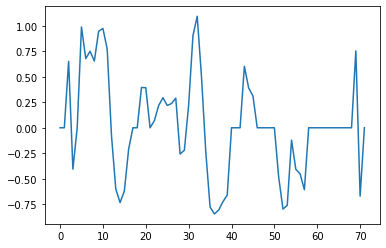

In [38]:
plt.plot(range(len(out['pitch'].numpy()[0])), out['pitch'].numpy()[0])
plt.show()

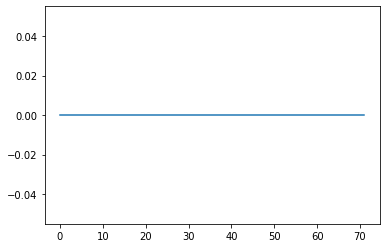

In [45]:
target_pitch = np.zeros_like(out['pitch'].numpy()) # flat pitch
plt.plot(range(len(out['pitch'].numpy()[0])), target_pitch[0])
plt.show()
out = tts_model.predict(text, encode=True, phoneme_pitch=target_pitch)
glim = audio.reconstruct_waveform(out['mel'].numpy().T)
voc = vocoder([out['mel'].numpy().T])[0]
ipd.display(ipd.Audio(glim, rate=audio.config['sampling_rate']))
ipd.display(ipd.Audio(voc, rate=audio.config['sampling_rate']))

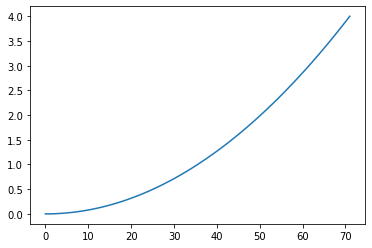

In [41]:
target_pitch = (np.linspace(0,2, len(out['pitch'].numpy()[0]))**2)[None,:,None] # increasing pitch
plt.plot(range(len(out['pitch'].numpy()[0])), target_pitch[0])
plt.show()
out = tts_model.predict(text, encode=True, phoneme_pitch=target_pitch)
glim = audio.reconstruct_waveform(out['mel'].numpy().T)
voc = vocoder([out['mel'].numpy().T])[0]
ipd.display(ipd.Audio(glim, rate=audio.config['sampling_rate']))
ipd.display(ipd.Audio(voc, rate=audio.config['sampling_rate']))

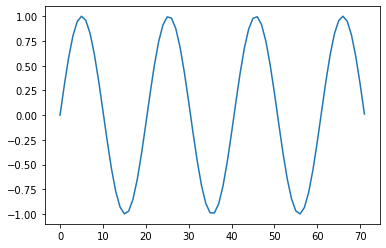

In [42]:
target_pitch = np.sin(np.linspace(0,3.14*7, len(out['pitch'].numpy()[0])))[None,:,None]
plt.plot(range(len(out['pitch'].numpy()[0])), target_pitch[0])
plt.show()
out = tts_model.predict(text, encode=True, phoneme_pitch=target_pitch)
glim = audio.reconstruct_waveform(out['mel'].numpy().T)
voc = vocoder([out['mel'].numpy().T])[0]
ipd.display(ipd.Audio(glim, rate=audio.config['sampling_rate']))
ipd.display(ipd.Audio(voc, rate=audio.config['sampling_rate']))

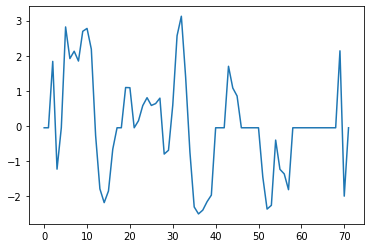

In [43]:
target_pitch = ((out['pitch'].numpy() - out['pitch'].numpy().mean()) * 1.9) + out['pitch'].numpy()
plt.plot(range(len(out['pitch'].numpy()[0])), target_pitch[0])
plt.show()
out = tts_model.predict(text, encode=True, phoneme_pitch=target_pitch)
glim = audio.reconstruct_waveform(out['mel'].numpy().T)
voc = vocoder([out['mel'].numpy().T])[0]
ipd.display(ipd.Audio(glim, rate=audio.config['sampling_rate']))
ipd.display(ipd.Audio(voc, rate=audio.config['sampling_rate']))